# Visualizing spatial data

Professional geospatial visualization and cartography is usually carried in dedicated software packages like **Adobe Illustrator** or **ArcGIS**. Most maps produced using programming tend to be simplistic and not particularly inspiring. But does this always have to be the case? There are a few specialists who have been able to produce visualling appealing maps and geovisualizations in Python. In this demo, we will see how far we can get with the `cartopy` package. 

In [1]:
import cartopy.crs as ccrs
import matplotlib.pyplot as plt
import warnings
warnings.filterwarnings('ignore')
import numpy as np

## World maps

We can plot a world map with the **Plate Carrée projection**, adding a coastline, grid lines, and labels like so.

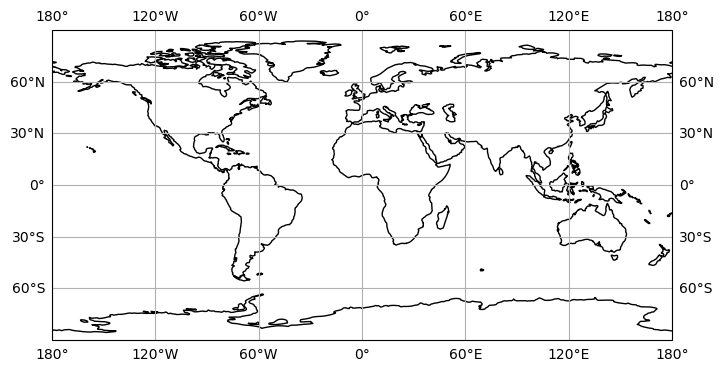

In [2]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.coastlines()
ax.gridlines(draw_labels=True)
plt.show()

`cartopy` supports many other projections that can be found [here](https://scitools.org.uk/cartopy/docs/v0.16/crs/projections.html#cartopy-projections). For example, a slightly better looking global projection is called **Robinson**. 

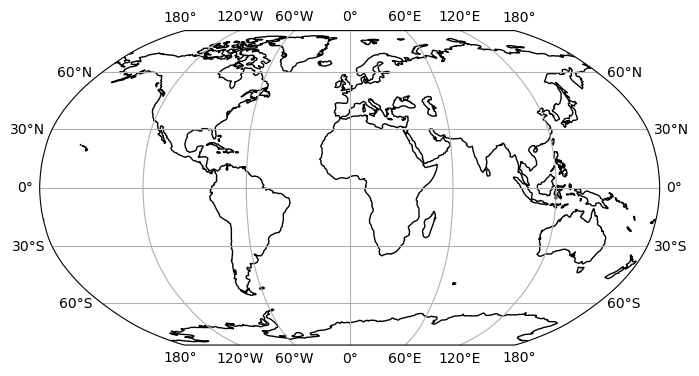

In [3]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.Robinson())
ax.coastlines()
ax.gridlines(draw_labels=True)
plt.show()

Then there are some more wacky one such as **InterruptedGoodeHomolosine**.

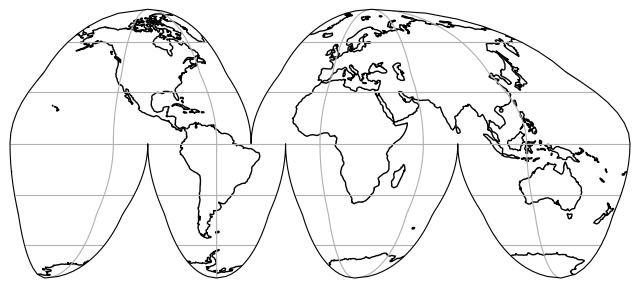

In [4]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.InterruptedGoodeHomolosine())
ax.coastlines()
ax.gridlines()
plt.show()

## Adding features

The [`cartopy.feature`](https://cartopy.readthedocs.io/stable/reference/feature.html#) module provides easy access to common geographic vector features (e.g. ocean, land, borders, etc.) that we can add to the map as layers to bring attention to certain features. 

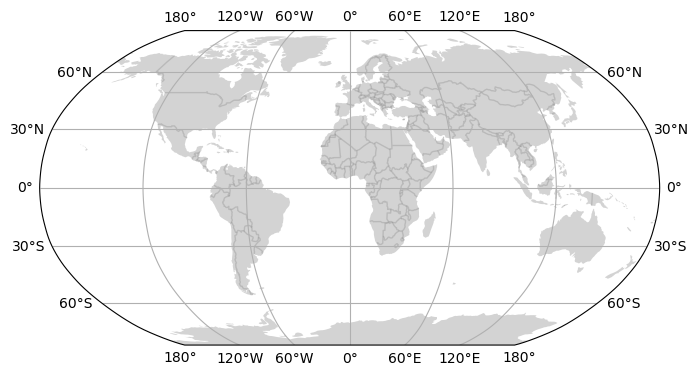

In [5]:
import cartopy.feature as cfeature

plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.Robinson())
ax.add_feature(cfeature.LAND, facecolor='lightgrey')
ax.add_feature(cfeature.BORDERS, edgecolor='grey', alpha=0.3)
ax.gridlines(draw_labels=True)
plt.show()

The `cartopy.feature` module also includes rivers and lakes.

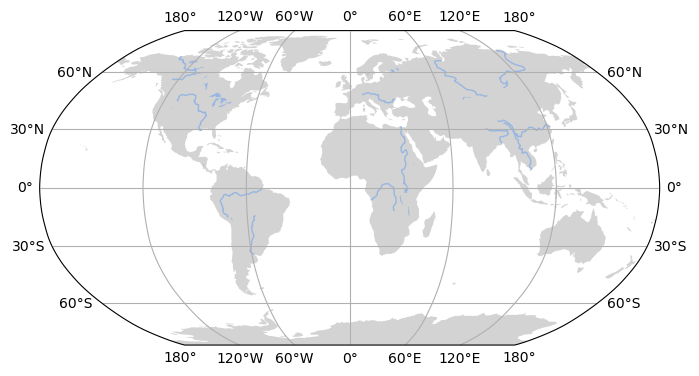

In [6]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.Robinson())
ax.add_feature(cfeature.LAND, facecolor='lightgrey')
ax.add_feature(cfeature.RIVERS)
ax.add_feature(cfeature.LAKES)
ax.gridlines(draw_labels=True)
plt.show()

These base maps provide a template for global map figures that are found in many scientific articles.

```{image} images/trawling.png
:width: 700px
:align: center
```

Zhang, W., Porz, L., Yilmaz, R. et al. Long-term carbon storage in shelf sea sediments reduced by intensive bottom trawling. Nat. Geosci. 17, 1268–1276 (2024). [https://doi.org/10.1038/s41561-024-01581-4](https://www.nature.com/articles/s41561-024-01581-4).

```{image} images/whs.png
:width: 700px
:align: center
```

Chen, Y., Wang, D., Zhang, L. et al. World Heritage documents reveal persistent gaps between climate awareness and local action. Nat. Clim. Chang. (2025). [https://doi.org/10.1038/s41558-025-02461-4](https://www.nature.com/articles/s41558-025-02461-4).

## Regional maps

If we want to zoom in on a specific region of the world, we can use `set_extent` function which expects **longitude** and **latitude** coordinates ordered by: x0, x1, y0, y1.

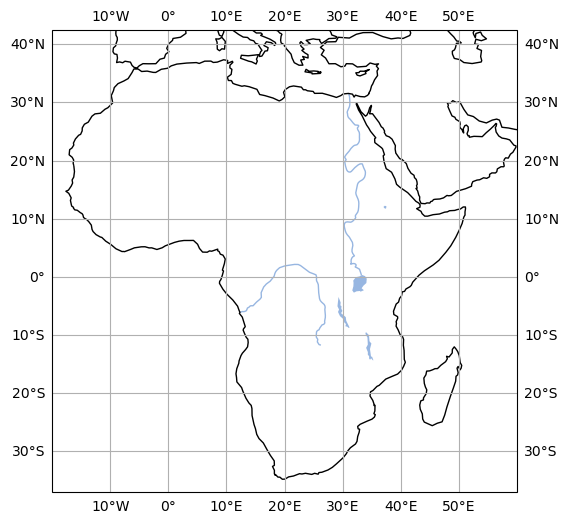

In [7]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([-20, 60, -30, 35])
ax.add_feature(cfeature.LAKES)
ax.add_feature(cfeature.RIVERS)
ax.coastlines()
ax.gridlines(draw_labels=True)
plt.show()

```{note}
We can still use longitude and latitude coordinates to define the extent even if our map is projected using a different projection (e.g. `SouthPolarStereo`). We jus need to define the projection system of the coordinates (i.e. `PlateCarree`) when we pass `set_extent`.  
```

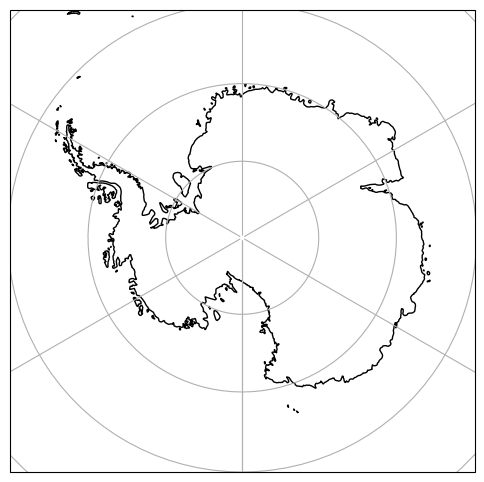

In [8]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.SouthPolarStereo())
ax.set_extent([-180, 180, -90, -60], ccrs.PlateCarree())
ax.coastlines()
ax.gridlines()
plt.show()

At some point, the resolution of the coastline starts to look a little coarse. 

```{note}
We can add points to the map using the `plot` function.
```

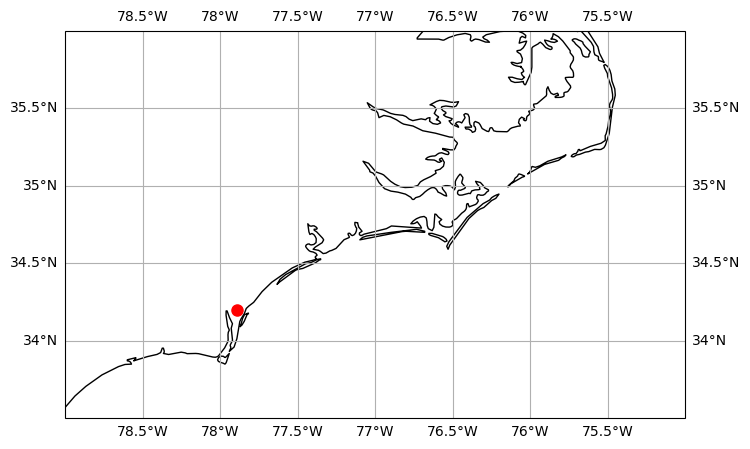

In [9]:
plt.figure(figsize = (8, 6))
ax = plt.axes(projection=ccrs.PlateCarree())
ax.set_extent([-79, -75, 33.5, 36])
ax.coastlines()
ax.gridlines(draw_labels=True)
ax.plot(-77.89, 34.20, 'o', color='red', markersize=8, transform=ccrs.PlateCarree())
plt.show()

## Adding vector data

To add more complex vector data such as polylines and polygons to o0ur map we can use the `add_geometries` function. This function expects a `shapely` geometry as well as projection system. Here `track` is a **polyline** that represents Hurricane Katrina's (2005) storm track and `track_buffer` is a **polygon** that represents a the storm track buffered by two degrees. 

In [10]:
import shapely.geometry as sgeom

lons = [-75.1, -75.7, -76.2, -76.5, -76.9, -77.7, -78.4, -79.0,
        -79.6, -80.1, -80.3, -81.3, -82.0, -82.6, -83.3, -84.0,
        -84.7, -85.3, -85.9, -86.7, -87.7, -88.6, -89.2, -89.6,
        -89.6, -89.6, -89.6, -89.6, -89.1, -88.6, -88.0, -87.0,
        -85.3, -82.9]

lats = [23.1, 23.4, 23.8, 24.5, 25.4, 26.0, 26.1, 26.2, 26.2, 26.0,
        25.9, 25.4, 25.1, 24.9, 24.6, 24.4, 24.4, 24.5, 24.8, 25.2,
        25.7, 26.3, 27.2, 28.2, 29.3, 29.5, 30.2, 31.1, 32.6, 34.1,
        35.6, 37.0, 38.6, 40.1]

# Convert lons and lats into a shapely LineString
track = sgeom.LineString(zip(lons, lats))

# Buffer the linestring by two degrees (note: this is a non-physical distance)
track_buffer = track.buffer(2)

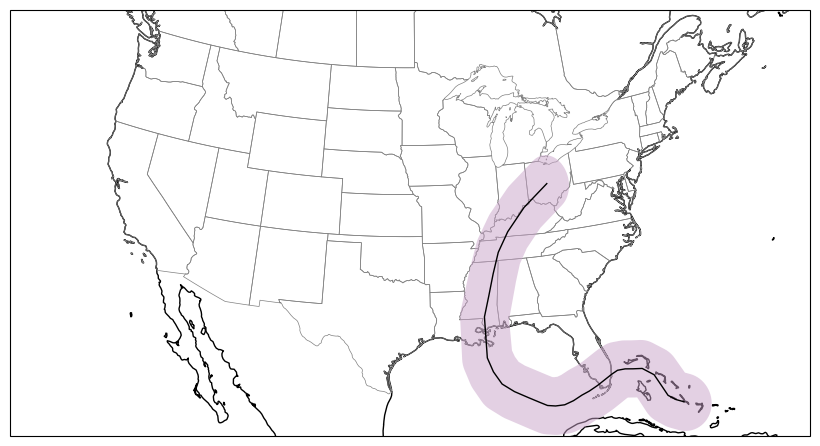

In [11]:
fig = plt.figure(figsize = (8, 6))
ax = fig.add_axes([0, 0, 1, 1], projection=ccrs.LambertConformal())
ax.set_extent([-125, -66.5, 20, 50], ccrs.Geodetic())
ax.coastlines()
ax.add_feature(cfeature.STATES.with_scale('50m'), edgecolor='gray', linewidth=0.5)
ax.add_geometries([track_buffer], ccrs.PlateCarree(),
                      facecolor='#C8A2C8', alpha=0.5)
ax.add_geometries([track], ccrs.PlateCarree(),
                  facecolor='none', edgecolor='k')
plt.show()

## Note on Plate Carree vs. Geodetic

**Plate Carree** is a projection system that flattens the Earth onto a 2D plane (in this case using **cylindrical** approach). The shortest distance between two points on a Plate Carree projection is therefore a **straight line** because latitude and longitude are treated as Cartesian coordinates. 

**Geodetic** coordinate system is a **spherical coordinate system** that defines locations on a 3D sphere using angular units. The shortest path between two points therefore looks curved when projected onto a Plate Carree map and explains why flying from Portland to London provides an opportunity to see the Greenland Ice Sheet from above. 

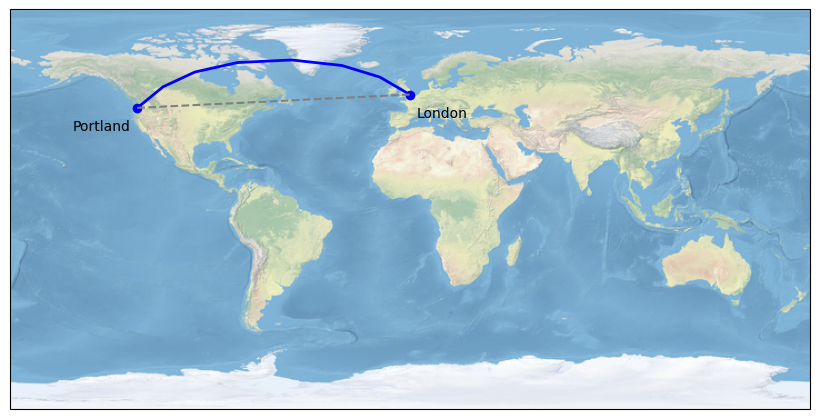

In [12]:
fig = plt.figure(figsize = (8, 6))
ax = fig.add_axes([0, 0, 1, 1], projection=ccrs.PlateCarree())
ax.stock_img()

portland_lon, portland_lat = -122.7, 45.5
london_lon, london_lat = -0.2, 51.5 

plt.plot([portland_lon, london_lon], [portland_lat, london_lat],
         color='blue', linewidth=2, marker='o',
         transform=ccrs.Geodetic(),
         )

plt.plot([portland_lon, london_lon], [portland_lat, london_lat],
         color='gray', linestyle='--',
         transform=ccrs.PlateCarree(),
         )

plt.text(portland_lon - 3, portland_lat - 10, 'Portland',
         horizontalalignment='right',
         transform=ccrs.Geodetic())

plt.text(london_lon + 3, london_lat - 10, 'London',
         horizontalalignment='left',
         transform=ccrs.Geodetic())

plt.show()

## Adding gridded data

We can use the `pcolormesh` function from `matplotlib` to plot gridded data. This function represents data as a **grid of colored blocks**. Each block corresponds to a data point and is filled with a solid color determined by the colormap and the value of that data point.

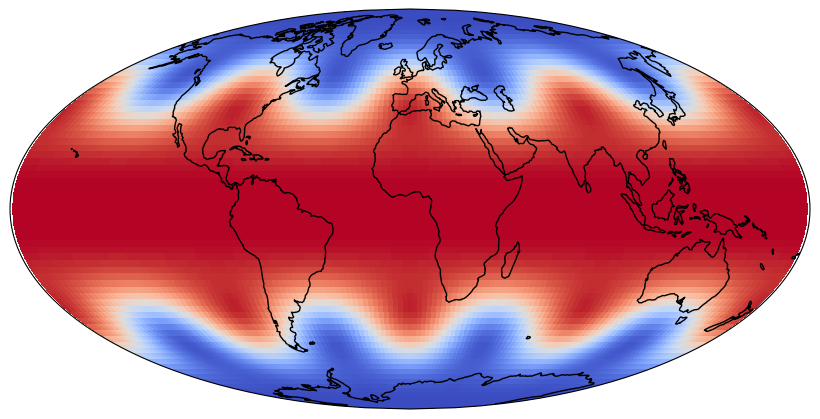

In [13]:
# Sample data
nlats, nlons = (73, 145)
lats = np.linspace(-np.pi / 2, np.pi / 2, nlats)
lons = np.linspace(0, 2 * np.pi, nlons)
lons, lats = np.meshgrid(lons, lats)
wave = 0.75 * (np.sin(2 * lats) ** 8) * np.cos(4 * lons)
mean = 0.5 * np.cos(2 * lats) * ((np.sin(2 * lats)) ** 2 + 2)

lats = np.rad2deg(lats)
lons = np.rad2deg(lons)
data = wave + mean

lons = (lons + 180) % 360 - 180

fig = plt.figure(figsize = (8, 6))
ax = fig.add_axes([0, 0, 1, 1], projection=ccrs.Mollweide())
ax.pcolormesh(lons, lats, data, transform=ccrs.PlateCarree(),
            cmap='coolwarm')
ax.coastlines()
plt.show()

Maps with gridded data are commonly used in scientific articles.

```{image} images/snowcover.png
:width: 700px
:align: center
```

Qing, Y., Wang, S., AghaKouchak, A. et al. Delayed formation of Arctic snow cover in response to wildland fires in a warming climate. Nat. Clim. Chang. 15, 1091–1098 (2025). [https://doi.org/10.1038/s41558-025-02443-6](https://www.nature.com/articles/s41558-025-02443-6).

```{image} images/dust.png
:width: 700px
:align: center
```

Meng, X., Yu, Y. & Ginoux, P. Rise in dust emissions from burned landscapes primarily driven by small fires. Nat. Geosci. 18, 586–592 (2025). [https://doi.org/10.1038/s41561-025-01730-3](https://www.nature.com/articles/s41561-025-01730-3).

## Topographic maps

```{important}
If we don't need coastlines or political boundaries, then we don't need to use `cartopy`. 
```

Below is an attempt to make a really nice topographic map of Oregon using elevation data. We will use **Global Multi-resolution Terrain Elevation Data (GMTED2010)** which was produced by the USGS and the National Geospatial-Intelligence Agency (NGA). The data has a spatial resolution of 7.5 arc-seconds and can be downloaded from the [Earth Explorer](https://earthexplorer.usgs.gov/). 

## Read elevation data

The first thing we do is open and read the data using `rasterio`. Remember that `open` methods produces a rasterio **dataset object**, which contains not only the elevation data but also information about the projection and extent of the image. The `read` method reads the data in the dataset object into a **2D `numpy` array**.

In [14]:
import rasterio
import matplotlib.pyplot as plt
import numpy as np

file = rasterio.open('data/30n150w_20101117_gmted_mea075.tif')
dataset = file.read()
print(dataset.shape)

(1, 9600, 14400)


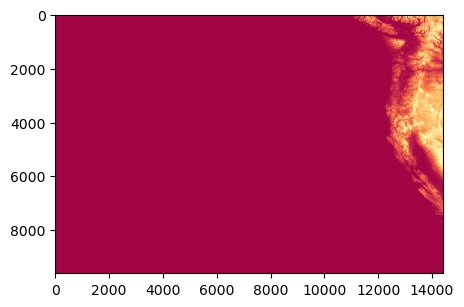

In [15]:
# Plot data
fig, ax = plt.subplots(figsize=(5,5))
ax.imshow(dataset[0,:,:], cmap='Spectral')
plt.show()

## Clip to study region

There is a lot of ocean in this plot because geospatial data is often tiled and usually never quite aligns with our study area. Luckily, `rasterio` has a useful method to clip rasters based on a georeferenced shape, e.g. a polygon. In this case we can use an polygon of Oregon which can be downloaded from the [Natural Earth database](https://www.naturalearthdata.com/downloads/10m-cultural-vectors/) to clip the raster using the `rasterio.mask.mask` function. 

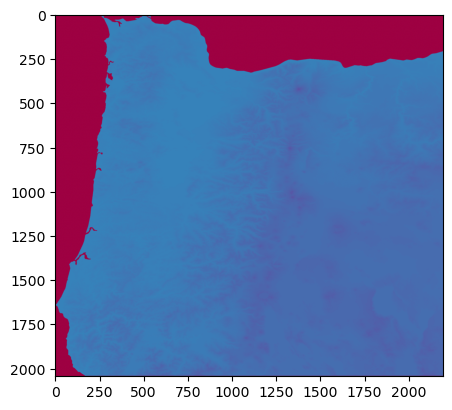

In [16]:
import geopandas as gpd
from shapely.geometry import mapping
from rasterio import mask as msk

# Read Oregon shapefile
oregon_poly = gpd.read_file('data/oregon.shp')

# Clip raster
clipped_array, clipped_transform = msk.mask(file, [mapping(oregon_poly.iloc[0].geometry)], crop=True)

# Plot
plt.figure(figsize=(5,5))
plt.imshow(clipped_array[0], cmap='Spectral')
plt.show()

Now we have only elevation values that correspond to Oregon. However, by default `rasterio.mask.mask` will assign all values that are not within the Oregon polygon as **zero**. While this is sensible, these zeros will make the plotting tricky because they act as an anchor at the bottom of the **colourmap**. If there is a large gap between zero and the minimum elevation value in Oregon, then the map above will be produced, with real data in one half of the colourmap and the other half of the colourmap absent because there is a gap between zero and the minimum of the real data. 

## Re-assign nodata values

Fortunately, the `mask` function allows us to explicitly set a specific value to grid cells that are not within the Oregon polygon with the `nodata` keyword argument. In the function below we pass the Oregon **GeoDataFrame** and the `rasterio` **dataset object**. 

Notice that the `mask` function is called twice, first it is called as above and values not within the Oregon polygon are returned as zeros. On the second occasion, the `nodata` argument is used and the values not part of the Oregon polygon are set to be **one greater than the maximum value** in the Oregon topography dataset (as calculated with the first mask). The result is that we now have a dataset with no natural gaps. Also being returned by this function is the `value_range` variable. This corresponds to the range between the smallest and largest value in `oregon_topography` array and is useful for constructing colourmaps later.

In [17]:
def clip_raster(gdf, img):
    clipped_array, clipped_transform = msk.mask(img, [mapping(gdf.iloc[0].geometry)], crop=True)
    clipped_array, clipped_transform = msk.mask(img, [mapping(gdf.iloc[0].geometry)],
                                                       crop=True, nodata=(np.amax(clipped_array[0]) + 1))
    clipped_array[0] = clipped_array[0] + abs(np.amin(clipped_array))
    value_range = np.amax(clipped_array) + abs(np.amin(clipped_array))
    return clipped_array, value_range

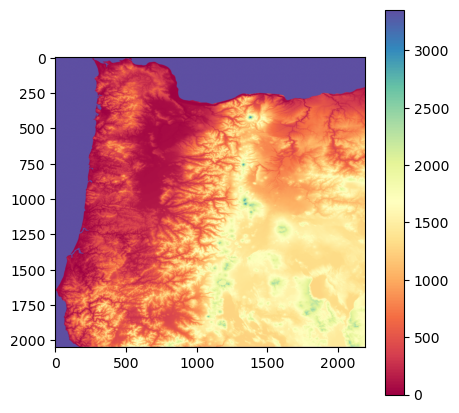

In [18]:
oregon_topography, value_range = clip_raster(oregon_poly, file)

plt.figure(figsize=(5,5))
c = plt.imshow(oregon_topography[0], cmap='Spectral')
plt.colorbar(c)
plt.show()

## Construct a colormap

Now we need to construct an appropriate **colourmap**. Here we make a five-class linear colormap using [ColorBrewer](https://colorbrewer2.org/) as inspiration. 

In [19]:
from matplotlib.colors import LinearSegmentedColormap
from matplotlib import colors

oregon_colormap = LinearSegmentedColormap.from_list('oregon', ['#edf8fb','#b2e2e2','#66c2a4','#2ca25f','#006d2c'],
                                                   N=value_range)

```{note}
All colors can be described using an **RGB triplet** or **hexadecimal** format (a hex triplet). In Python, hexadecimal color codes are defined with a leading number sign (`#`). More information can be found [here](https://en.wikipedia.org/wiki/Web_colors)
```

We still need to deal with the values that are not within Oregon. The solution is to construct a **colormap** with enough colours that each unique value within the Oregon elevation data has it's own colour, then replace the last colour in the colormap with our **background color**. 

In [20]:
from matplotlib.colors import ListedColormap

# Define an RGBA color
background_color = np.array([0.9882352941176471, 0.9647058823529412, 0.9607843137254902, 1.0])

newcolors = oregon_colormap(np.linspace(0, 1, value_range))
newcolors = np.vstack((newcolors, background_color))
oregon_colormap = ListedColormap(newcolors)

```{note}
This time we defined the background color using an **RGB triplet** + an alpha value which defines transparency.
```

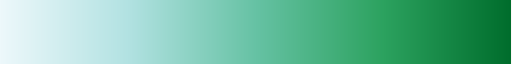

In [21]:
oregon_colormap

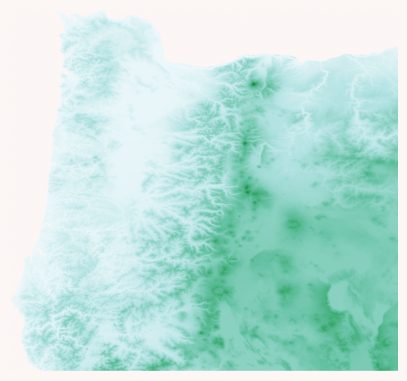

In [22]:
# Plot
fig = plt.figure(facecolor='#FCF6F5FF', figsize=(5,5))
ax = plt.axes()
plt.imshow(oregon_topography[0], cmap=oregon_colormap)
ax.axis('off')
plt.show()

## Adding a hillshade

The final step is to add a hillshade to mimic light shining on the topography. A hillshade is a 3D representation of a surface and are generally rendered in greyscale. The darker and lighter colors represent the shadows and highlights that you would visually expect to see in a terrain model.

We will use [`EarthPy`](https://earthpy.readthedocs.io/en/latest/index.html) to generate our hillshade data. There are two parameters that can be tuned and they give very different results depending on the dataset. The first is the **azimuth value** which can range from 0-360 degrees and relates to where the light source is shining from. 0 degrees corresponds to a light source pointing due north. The second is the altitude of the light source and can range from 1-90. Below are some examples demonstrating how changing the **azimuth value** produces vastly different results.

```{note}
`EarthPy` can be installed by running `pip install earthpy` from the terminal or command prompt.
```

(np.float64(-0.5), np.float64(2191.5), np.float64(2043.5), np.float64(-0.5))

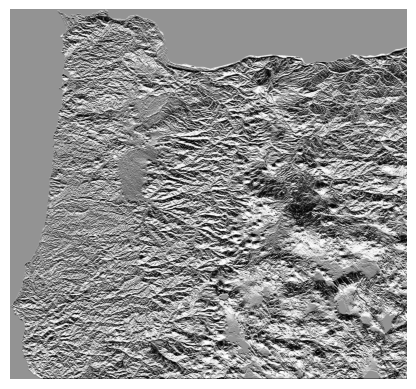

In [23]:
import earthpy.spatial as es

hillshade = es.hillshade(oregon_topography[0], 
                         azimuth=0, altitude=1)
plt.imshow(hillshade, cmap='Greys')
plt.axis('off')

(np.float64(-0.5), np.float64(2191.5), np.float64(2043.5), np.float64(-0.5))

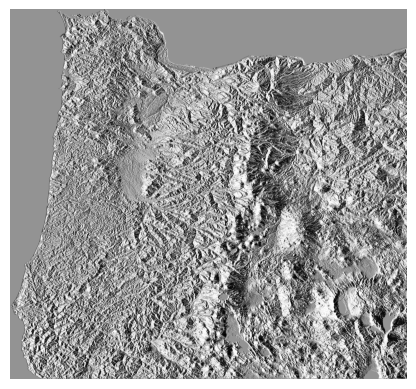

In [24]:
hillshade = es.hillshade(oregon_topography[0], 
                         azimuth=90, altitude=1)
plt.imshow(hillshade, cmap='Greys')
plt.axis('off')

(np.float64(-0.5), np.float64(2191.5), np.float64(2043.5), np.float64(-0.5))

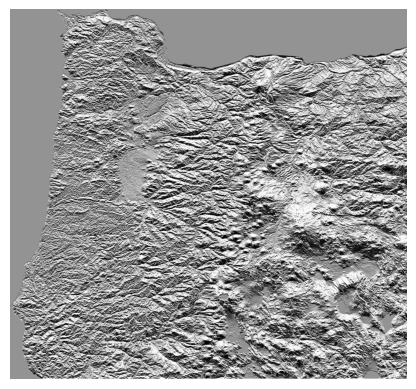

In [25]:
hillshade = es.hillshade(oregon_topography[0], 
                         azimuth=180, altitude=1)
plt.imshow(hillshade, cmap='Greys')
plt.axis('off')

(np.float64(-0.5), np.float64(2191.5), np.float64(2043.5), np.float64(-0.5))

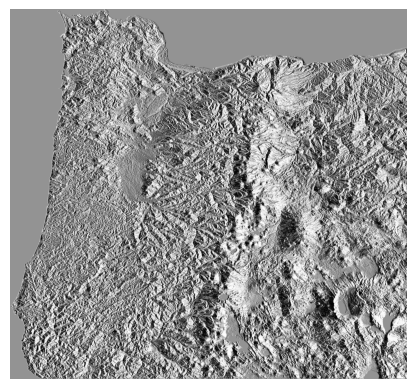

In [26]:
hillshade = es.hillshade(oregon_topography[0], 
                         azimuth=270, altitude=1)
plt.imshow(hillshade, cmap='Greys')
plt.axis('off')

An azimuth value of 90 produces a nice shadow on the eastern side of the Cascades and Crater Lake. Definitely play around with these values though because there may be even better hillshades.

## Plot map

We can now plot the finished product. To do is we first plot the Oregon topography, then overlay the hillshade with a small **alpha value** that sets transparency. 

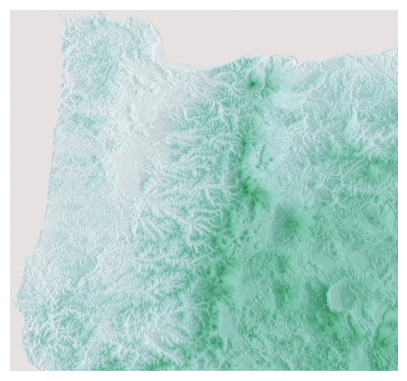

In [27]:
fig, ax = plt.subplots(figsize=(5,5))
im = plt.imshow(oregon_topography[0], 
                cmap=oregon_colormap)
ax.imshow(hillshade, cmap='Greys', alpha=0.2)
ax.axis('off')
plt.show()

## Add a colorbar and scalebar

If we were producing a figure for a journal article, we may also want to add a **colorbar** and a **scalebar**. A colorbar is fairly simple in `Matplotlib` but the default option is a little clumsy. The code below allows us to make the colorbar match the size of the plot.

Adding a scalebar in is a little more annoying because `Matplotlib` doesn't have any native functions to do this. But there is a package called [`matplotlib_scalebar`](https://github.com/ppinard/matplotlib-scalebar) that we can install which does the trick. 

We just have to find the size of each pixel in meters. We can use this [website](https://www.opendem.info/arc2meters.html) to convert 7.5 arc-seconds to meters at a specific latitude. 

```{note}
`matplotlib_scalebar` can be installed by running `pip install matplotlib-scalebar` from the terminal or command prompt.
```

In [28]:
from mpl_toolkits.axes_grid1 import make_axes_locatable
from matplotlib_scalebar.scalebar import ScaleBar

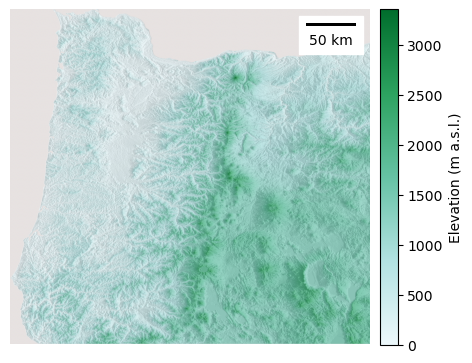

In [29]:
fig, ax = plt.subplots(figsize=(5,5))
im = plt.imshow(oregon_topography[0], cmap=oregon_colormap)
ax.imshow(hillshade, cmap='Greys', alpha=0.2)
ax.axis('off')

# Colorbar
divider = make_axes_locatable(ax)
cax = divider.append_axes('right', size='5%', pad=0.10)
fig.colorbar(im, cax=cax, orientation='vertical', 
             label='Elevation (m a.s.l.)')

#Scalebar
scalebar = ScaleBar(164,"m", length_fraction=0.2, pad=0.5, 
                    border_pad=0.5, location=1)
ax.add_artist(scalebar)
plt.show()

There we have it, a visually appealing topographic map of *most* of Orgeon ready to hang on a wall (or sell on Etsy...). 

## Census data

In the final part of this lecture, we will use Python to produce another type of thematic map. But this instead of representing elevation data, we will visualize Census Bureau data.

We can automatically download Census Bureau data from the 2019 American Community Survey using `census`. 

In [30]:
from census import Census
c = Census("cf7bfd71f6e64ddabdc65b3c7e00ebe11de9eea2")

## Search for data

Inspired by the article "[Plumbing Poverty: Mapping Hot Spots of Racial and Geographic Inequality in U.S. Household Water Insecurity](https://www.tandfonline.com/doi/abs/10.1080/24694452.2018.1530587)" by Shiloh Deitz and Katie Meehan (2019), we will search for data that determines whether household have adequate plumbing facilities. 

The Census Bureau defines "complete plumbing facilities" as (1) piped hot and cold water, (2) a flush toilet, and (3) a bathtub or shower, all located within the housing unit and used only by occupants. 

We can do a `Ctrl + F` to find the variables associated with plumbing facilities o: [https://api.census.gov/data/2019/acs/acs5/variables.html](https://api.census.gov/data/2019/acs/acs5/variables.html)

```{image} images/plumbing.png
:width: 1000px
:align: center
```

In [31]:
import pandas as pd
variable_list = ['B25047_001E', 'B25047_002E', 'B25047_003E']
data = c.acs5.state_county((variable_list), '37', Census.ALL)
df = pd.DataFrame(data)

In [32]:
df.head()

,B25047_001E,B25047_002E,B25047_003E,state,county
0,75456.0,74132.0,1324.0,37,001
1,16126.0,15333.0,793.0,37,003
2,7752.0,7596.0,156.0,37,005
3,9932.0,9466.0,466.0,37,007
4,17111.0,16863.0,248.0,37,009


## Add spatial data

We can add the geometries of the counties using a shapefile that represents the corresponding geographic units from [here](https://www2.census.gov/geo/tiger/TIGER2021/). We are interested in **county** level data we would navigate to the `COUNTY/` folder and download the `.zip` file for North Carolina (i.e. `tl_2021_us_county.zip`)

In [33]:
counties = gpd.read_file('data/tl_2021_us_county/tl_2021_us_county.shp')
counties.head()

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,CBSAFP,METDIVFP,FUNCSTAT,ALAND,AWATER,INTPTLAT,INTPTLON,geometry
0,31,039,00835841,31039,Cuming,Cuming County,06,H1,G4020,None,None,None,A,1477645345,10690204,+41.9158651,-096.7885168,"POLYGON ((-96.55516 41.91587, -96.55515 41.914..."
1,53,069,01513275,53069,Wahkiakum,Wahkiakum County,06,H1,G4020,None,None,None,A,680976231,61568965,+46.2946377,-123.4244583,"POLYGON ((-123.49077 46.38358, -123.48813 46.3..."
2,35,011,00933054,35011,De Baca,De Baca County,06,H1,G4020,None,None,None,A,6016818946,29090018,+34.3592729,-104.3686961,"POLYGON ((-104.38368 34.69213, -104.37658 34.6..."
3,31,109,00835876,31109,Lancaster,Lancaster County,06,H1,G4020,339,30700,None,A,2169272970,22847034,+40.7835474,-096.6886584,"POLYGON ((-96.6814 41.04566, -96.68139 41.0456..."
4,31,129,00835886,31129,Nuckolls,Nuckolls County,06,H1,G4020,None,None,None,A,1489645185,1718484,+40.1764918,-098.0468422,"POLYGON ((-98.04802 40.35066, -98.04674 40.350..."


## Merge

In [34]:
plumbing = pd.merge(counties, df, left_on=['STATEFP', 'COUNTYFP'], right_on=['state', 'county'], how='inner')
plumbing.head()

,STATEFP,COUNTYFP,COUNTYNS,GEOID,NAME,NAMELSAD,LSAD,CLASSFP,MTFCC,CSAFP,...,ALAND,AWATER,INTPTLAT,INTPTLON,geometry,B25047_001E,B25047_002E,B25047_003E,state,county
0,37,037,01008544,37037,Chatham,Chatham County,06,H1,G4020,450,...,1765540362,70582736,+35.7049939,-079.2514542,"POLYGON ((-79.24113 35.57054, -79.24138 35.570...",35013.0,34622.0,391.0,37,037
1,37,001,01008531,37001,Alamance,Alamance County,06,H1,G4020,268,...,1096736059,27940532,+36.0439535,-079.4005733,"POLYGON ((-79.43277 35.84368, -79.43396 35.843...",75456.0,74132.0,1324.0,37,001
2,37,057,01008548,37057,Davidson,Davidson County,06,H1,G4020,268,...,1432728609,37604804,+35.7951312,-080.2071070,"POLYGON ((-80.06476 35.56138, -80.06477 35.560...",75615.0,73418.0,2197.0,37,057
3,37,069,01008553,37069,Franklin,Franklin County,06,H1,G4020,450,...,1273761673,7173998,+36.0882406,-078.2830903,"POLYGON ((-78.11729 36.03752, -78.11743 36.037...",30790.0,29761.0,1029.0,37,069
4,37,155,01026130,37155,Robeson,Robeson County,06,H1,G4020,246,...,2453481924,5076395,+34.6392096,-079.1008811,"POLYGON ((-79.12835 34.88294, -79.12795 34.883...",48874.0,46781.0,2093.0,37,155


In [35]:
# Compute proportion of household with inadequate plumbing
plumbing['lack_plumbing_percent'] = plumbing['B25047_003E'] / plumbing['B25047_001E']

## Simple choropleth map

`GeoPandas` provides a high-level interface to the `Matplotlib` library for making maps. It is as easy as using the `plot()` method on a `GeoDataFrame`. 

<Axes: >

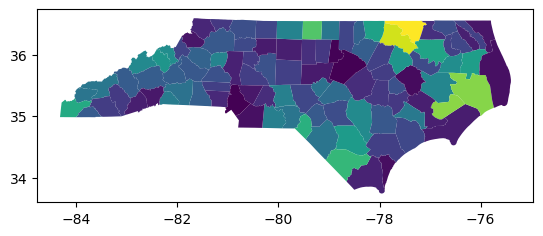

In [36]:
plumbing.plot('lack_plumbing_percent')

## Improving the choropleth map

This is useful for a quick look over the data but we would prefer to customize our plot. For instance, we should add a title, colorbar, and nicer colormap. 

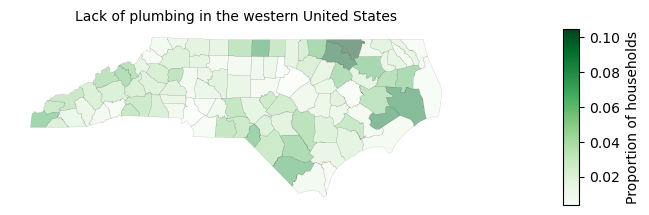

In [37]:
fig, ax = plt.subplots(figsize=(8,5))

plt.title('Lack of plumbing in the western United States', fontsize=10)
ax.set_axis_off()
divider = make_axes_locatable(ax)
cax = divider.append_axes("right", size="3%", pad=0.5,alpha=0.5)
plumbing.plot('lack_plumbing_percent', ax=ax, alpha=0.5, cmap='Greens', 
              edgecolor='k', legend=True, cax=cax, linewidth=0.1)
plt.ylabel('Proportion of households', fontsize=10)
plt.show()

## Interactive plots

Alongside static plots, `GeoPandas` can produce [interactive maps](https://geopandas.org/en/stable/docs/user_guide/interactive_mapping.html) based on the [`Folium`](https://github.com/python-visualization/folium) library, which is itself based on [`Leaflet`](https://leafletjs.com/). 

In [38]:
m = plumbing.explore(
     column="lack_plumbing_percent", # make choropleth based on column
     scheme="naturalbreaks",         # use mapclassify's natural breaks scheme
     tooltip="lack_plumbing_percent",# show column value in tooltip (on hover)
     popup=True,                     # show all values in popup (on click)
     tiles="CartoDB positron",       # use "CartoDB positron" tiles
     cmap="Greens",                  # use "Greens" matplotlib colormap
     style_kwds=dict(color="black", weight=0.5) # use black outline with weight of 1
    )
m

## Conclusions

Maps made using programming don't have to be terrible - it is possible to produce visually appealing maps in Python. They may never be quite as good as what professional cartographers can produce in Adobe Illustrator but they have other advantages. Once the code is written, we can quickly make edits or add another dataset. I hope this demo has inspired you to improve the quality of your Python plots! 

## Further reading

[Cartopy docs](https://cartopy.readthedocs.io/stable/)
